# DSFB Assignment 2

In this assignment, you will begin to work with data to build some basic models. 

In this part of the assignment you will try to predict the probability of defaulting on a credit card account at a Taiwanese bank. A credit card default happens when a customer fails to pay the minimum due on a credit card bill for more than 6 months. 

You will use a dataset from a Taiwanese bank with 30,000 observations (Source: *Yeh, I. C., & Lien, C. H. (2009). The comparisons of data mining techniques for the predictive accuracy of probability of default of credit card clients. Expert Systems with Applications, 36(2), 2473-2480.*). Each observation represents an account at the bank at the end of October 2005.  We renamed the variable default_payment_next_month to customer_default. The target variable to predict is `customer_default` -- i.e., whether the customer will default in the following month (1 = Yes or 0 = No). The dataset also includes 23 other explanatory features. 

Variables are defined as follows:

| Feature name     | Variable Type | Description 
|------------------|---------------|--------------------------------------------------------
| customer_default | Binary        | 1 = default in following month; 0 = no default 
| LIMIT_BAL        | Continuous    | Credit limit   
| SEX              | Categorical   | 1 = male; 2 = female
| EDUCATION        | Categorical   | 1 = graduate school; 2 = university; 3 = high school; 4 = others
| MARRIAGE         | Categorical   | 0 = unknown; 1 = married; 2 = single; 3 = others
| AGE              | Continuous    | Age in years  
| PAY1             | Categorical   | Repayment status in September, 2005 
| PAY2             | Categorical   | Repayment status in August, 2005 
| PAY3             | Categorical   | Repayment status in July, 2005 
| PAY4             | Categorical   | Repayment status in June, 2005 
| PAY5             | Categorical   | Repayment status in May, 2005 
| PAY6             | Categorical   | Repayment status in April, 2005 
| BILL_AMT1        | Continuous    | Balance in September, 2005  
| BILL_AMT2        | Continuous    | Balance in August, 2005  
| BILL_AMT3        | Continuous    | Balance in July, 2005  
| BILL_AMT4        | Continuous    | Balance in June, 2005 
| BILL_AMT5        | Continuous    | Balance in May, 2005  
| BILL_AMT6        | Continuous    | Balance in April, 2005  
| PAY_AMT1         | Continuous    | Amount paid in September, 2005
| PAY_AMT2         | Continuous    | Amount paid in August, 2005
| PAY_AMT3         | Continuous    | Amount paid in July, 2005
| PAY_AMT4         | Continuous    | Amount paid in June, 2005
| PAY_AMT5         | Continuous    | Amount paid in May, 2005
| PAY_AMT6         | Continuous    | Amount paid in April, 2005

The measurement scale for repayment status is:   

    -2 = payment two months in advance   
    -1 = payment one month in advance   
    0 = pay duly   
    1 = payment delay for one month   
    2 = payment delay for two months   
    3 = payment delay for three months   
    4 = payment delay for four months   
    5 = payment delay for five months   
    6 = payment delay for six months   
    7 = payment delay for seven months   
    8 = payment delay for eight months   
    9 = payment delay for nine months or more  

## IMPORTS

Here are a bunch of libraries that you may need to use...

In [1]:
# Standard imports
import math
import numpy  as np
import pandas as pd

import itertools
import random

# Plotting
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
%matplotlib inline  
import seaborn as sns
sns.set(style="white")

# scikit-learn
from sklearn.dummy           import DummyClassifier
from sklearn.linear_model    import LogisticRegression
from sklearn.linear_model    import LinearRegression
from sklearn.linear_model    import Lasso

# Supporting functions from scikit-learn
from sklearn.metrics         import confusion_matrix
from sklearn.metrics         import roc_curve
from sklearn.metrics         import roc_auc_score
from sklearn.preprocessing   import StandardScaler
from sklearn.model_selection import train_test_split


# ignore some warnings 
import warnings
warnings.filterwarnings('ignore')

# Set a seed for replication
SEED = 1  # Use this anywhere a stochastic function allows you to set a seed

## Custom Functions

We are providing you these functions to make your life much easier. You can call these functions in order to plot a confusion matrix and/or a ROC curve. To use them, however, you will FIRST have to obtain the appropriate object by calling a scikit-learn function. We will give hints about that below...

In [2]:
def plot_confusion_matrix(cm, classes=[0,1], normalize=False, title='Confusion Matrix', cmap=plt.cm.Reds):
    """ 
    Function to plot a sklearn confusion matrix, showing number of cases per prediction condition. 
    The cm parameter can be an object created by the sklearn confusion_matrix() function.
    
    Args:
        cm         this must be a sklearn confusion matrix 
        classes    levels of the class being predicted; default to binary outcome
        normalize  apply normalization by setting `normalize=True`
        title      title for the plot
        cmap       color map
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    thresh = cm.max() / 2.0
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, round (cm[i, j],2), horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
    plt.tight_layout()
    plt.ylabel('Actual label')
    plt.xlabel('Predicted label')

In [3]:
def plot_roc(fpr, tpr, title='ROC Curve', note=''):
    """
    Function to plot a ROC curve in a consistent way.
    The fpr and tpr parameters can be created by the sklearn roc_curve() function.
    
    Args:
        fpr        False Positive Rate (list of multiple points)
        tpr        True Positive Rate (list of multiple points)
        title      Title above the plot
        note       Note to display in the bottom-right of the plot
    """
    plt.figure(1)
    plt.plot([0, 1], [0, 1], 'k--')
    plt.plot(fpr, tpr)
    plt.xlabel('False positive rate')
    plt.ylabel('True positive rate')
    plt.title(title)
    if note: plt.text(0.6, 0.2, note)
    plt.show()

# PART 1: EXPLORATORY DATA ANALYSIS

**PROBLEM**: Load the data into a pandas dataframe called `data`, then list out the columns.

In [8]:
# Load data
data=pd.read_csv('data/credit_data.csv')
data.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,customer_default
0,1,20000,2,2,1,24,2,2,-1,-1,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


In [10]:
# View columns
data.columns



Index(['ID', 'LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_1',
       'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',
       'customer_default'],
      dtype='object')

**PROBLEM**: Do some exploratory data analysis on the feature EDUCATION. Comment on what you observe. Can you use this variable with no modifications? Why or why not?

In [12]:
# Investigate 'education'

data.EDUCATION.value_counts()


2    14030
1    10585
3     4917
5      280
4      123
6       51
0       14
Name: EDUCATION, dtype: int64

ANSWER: There is a mismatch between the data description and the actual data: there are 14 zero values, 51 "6" values and 280 "5" values that theoretically should not be there. 

**PROBLEM**: How many female customers defaulted in the dataset? 

In [15]:
# Code to answer Problem
#look at real values of sex
#data.SEX.value_counts()
data[data.SEX==2].customer_default.value_counts()

0    14349
1     3763
Name: customer_default, dtype: int64

ANSWER: 3763

**PROBLEM**: Analyze the MARRIAGE variable by the target variable (customer_default), using g the pandas crosstab() function (this will show totals by level of Marriage. For an excellent answer, also show overall total counts (ignoring customer_default) by level of Marriage.

In [17]:
# Code to answer Problem
#0 = unknown; 1 = married; 2 = single; 3 = others
ct = pd.crosstab(data.MARRIAGE, data.customer_default)
ct['Total'] = ct[0] + ct[1]
ct


customer_default,0,1,Total
MARRIAGE,,,
0,49,5,54
1,10453,3206,13659
2,12623,3341,15964
3,239,84,323


**PROBLEM**: What is the data type of all features in this dataframe (as imported by Pandas)?

In [18]:
# Check data types

data.dtypes


ID                  int64
LIMIT_BAL           int64
SEX                 int64
EDUCATION           int64
MARRIAGE            int64
AGE                 int64
PAY_1               int64
PAY_2               int64
PAY_3               int64
PAY_4               int64
PAY_5               int64
PAY_6               int64
BILL_AMT1           int64
BILL_AMT2           int64
BILL_AMT3           int64
BILL_AMT4           int64
BILL_AMT5           int64
BILL_AMT6           int64
PAY_AMT1            int64
PAY_AMT2            int64
PAY_AMT3            int64
PAY_AMT4            int64
PAY_AMT5            int64
PAY_AMT6            int64
customer_default    int64
dtype: object

ANSWER:  int64 - integer

**PROBLEM**: Plot a "boxplot" of the variable LIMIT_BAL.

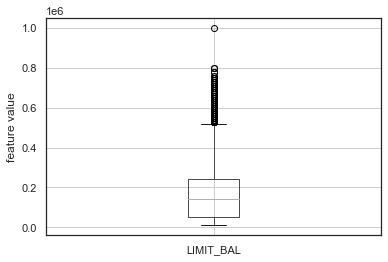

In [31]:
# Check distribution of the Credit Limit using box plot
data.boxplot(column='LIMIT_BAL')
plt.ylabel('feature value')
plt.show()

**PROBLEM**: What is the minimum value of LIMIT_BAL?

In [30]:
# Code to answer Problem
#np.min(data.LIMIT_BAL)
data.LIMIT_BAL.min()

10000

**PROBLEM**: Install the python package "pandas_profiling" and run an automated "profile_report" on your dataset. HINT: We did not import it for you... you'll need to install and import it yourself

In [ ]:
# Code to answer Problem



In [33]:
# Run a profiling report
import pandas_profiling
data.profile_report()

**PROBLEM**: One-hot-encode SEX and MARRIAGE

In [34]:
# Code to answer Problem

data = pd.get_dummies(data=data, columns=['SEX', 'MARRIAGE'])

**PROBLEM**: Run some code to prove that SEX and MARRIAGE are now one-hot-encoded and are now binary indicators (also called dummy variables).

In [35]:
# View columns

print('\n'.join(data.columns))


ID
LIMIT_BAL
EDUCATION
AGE
PAY_1
PAY_2
PAY_3
PAY_4
PAY_5
PAY_6
BILL_AMT1
BILL_AMT2
BILL_AMT3
BILL_AMT4
BILL_AMT5
BILL_AMT6
PAY_AMT1
PAY_AMT2
PAY_AMT3
PAY_AMT4
PAY_AMT5
PAY_AMT6
customer_default
SEX_1
SEX_2
MARRIAGE_0
MARRIAGE_1
MARRIAGE_2
MARRIAGE_3


In [36]:
# Code to answer Problem

data['MARRIAGE_0'].value_counts() 

0    29946
1       54
Name: MARRIAGE_0, dtype: int64

In [37]:
# Code to answer Problem

data['MARRIAGE_1'].value_counts() 

0    16341
1    13659
Name: MARRIAGE_1, dtype: int64

In [38]:
# Code to answer Problem
data['MARRIAGE_2'].value_counts() 


1    15964
0    14036
Name: MARRIAGE_2, dtype: int64

In [39]:
# Code to answer Problem
data['MARRIAGE_3'].value_counts() 


0    29677
1      323
Name: MARRIAGE_3, dtype: int64

# Use the following to help get you going... 

The following code assumes that you have already loaded your data into a pandas dataframe named `data`. It selects data for the target variable into an array (`y`) and the features into a new dataframe called (`X`).  

In [40]:
# Select target
y = np.array(data['customer_default'])

# Select features 
features = list(set(list(data.columns)) - set(['customer_default']))
X = data.loc[:, features]

We will start with a simple testing procedure where we split the data into two subsets: one for "training" and one for "testing." Use the `sklearn` function `train_test_split()`  to split your data. 

In [41]:
# Divide data into a training set and a testing set using the train_test_split() function
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=1, stratify=y)

You should now start to use the subset datasets of: `X_train` ,  `X_test` , `y_train` , `y_test`

# PART 2: RANDOM GUESSING MODEL

To start, let's run a truly "dumb" model that makes a random guess each time.

**PROBLEM**: Predict the outcome by guessing.

In [54]:
# Predict a guess  (store into a variable starting with the name `y_hat`...)

y_hat=np.random.randint(2,size=X_test.shape[0])


**PROBLEM**: Tabulate the predicted values so we can see what it predicted. There are many different ways to do this - pick one that works for you.

In [60]:
# Tabulate value counts by level of the predicted variable 

pd.Series(y_hat).value_counts()


0    3050
1    2950
dtype: int64

**PROBLEM**: What is the Standard Deviation of the prediction? Does that make sense? Explain why.

In [62]:
# What is the Standard Deviation of the prediction?


y_hat.std()

0.49993055073235476

ANSWER:   yes, because the probability to get 0 is 50 % and the probability to get 1 is 50 %

**PROBLEM**: Calculate and plot a confusion matrix.

HINT: Use the custom function `confusion_matrix()` defined at the top of the notebook.

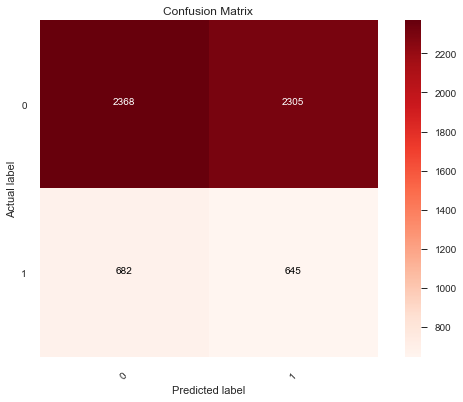

In [65]:
# Calculate a confusion matrix
cm=confusion_matrix(y_test, y_hat)
plot_confusion_matrix(cm)


**PROBLEM**: How many errors did the dumb baseline model make?

In [66]:
# How many errors did the baseline model make?


(y_hat-y_test).sum()

1623

**PROBLEM**: Calculate the accuracy. Does it make sense? Why or why not? Is this a good measure? why or why not?

In [68]:
# Calculate accuracy

from sklearn.metrics import accuracy_score
accuracy_score(y_test, y_hat)

0.5021666666666667

ANSWER:  yes, the accuracy makes sense, because random choice of 1 of 2 digits is equally possible event (~head/tail). The accuracy could be better, so it is not good measure 

# PART 3: BASELINE MODEL

Now let's start our analysis of viable prediction models with a very simple (but dumb) baseline model that always predicts the most frequent outcome. The results of this model will give you sense of how well more complex model perform relative to a baseline model.

**PROBLEM**: Find most frequent outcome  

In [91]:
# Calculate the most frequent outcome (do it with code!) - 0 is the most frequent outcome in y_train
print(y_train.sum(), len(y_train)-y_train.sum())
from collections import Counter
b = Counter(y_train)
print(b.most_common()[0])

5309 18691
(0, 18691)


**PROBLEM**: Predict the most frequent outcome (store into a variable starting with the name `y_hat`...). Then tabulate it to check you did it right. There are many different ways to tabulate - pick one that works for you.

In [141]:
# Predict the most frequent outcome into a variable called y_hat and then tabulate it to check. 

y_hat=np.zeros(X_test.shape[0], dtype=int)
pd.Series(y_hat).value_counts()

0    6000
dtype: int64

**PROBLEM**: What is the Standard Deviation of the prediction? Does that make sense? Explain why.

In [101]:
# What is the Standard Deviation of the prediction?


y_hat.std()

0.0

ANSWER:  yes, because there is only 1 value

**PROBLEM**: Calculate and plot a confusion matrix.

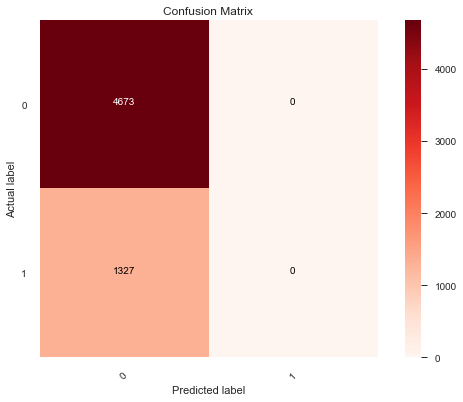

In [142]:
# Calculate a confusion matrix

cm=confusion_matrix(y_test, y_hat)
plot_confusion_matrix(cm)


**PROBLEM**: How many errors did the dumb baseline model make?

In [143]:
# How many errors did the baseline model make?
#1327

(y_test-y_hat).sum()

1327

**PROBLEM**: Calculate the accuracy. Does it make sense? Why or why not? Is this a good measure? why or why not?

In [144]:
# Calculate accuracy

from sklearn.metrics import accuracy_score
accuracy_score(y_test, y_hat)


0.7788333333333334

In [145]:
#remember the ratio of zeros in train 
1-y_train.sum()/len(y_train)

0.7787916666666667

ANSWER:  good answer because this is better than random but could be better. The asnwer makes sense because the ration of 0 values in train is almost equal the accuracy that we got

# PART 4: LINEAR PROBABILITY MODEL

Repeat the analysis using a linear (OLS) probability model. You can start with the code below -- it shows you how to define, fit, and predict a model from sklearn.

In [394]:
# Fit an OLS linear regression

lr = LinearRegression().fit(X_train, y_train)


**PROBLEM**: Plot the predicted probabilities (sorted low to high). Do they look reasonable? Why or why not?

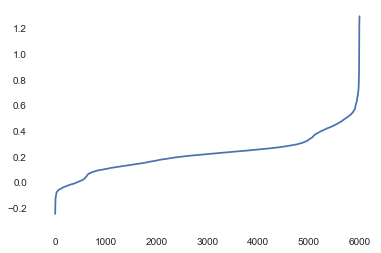

In [417]:
# Code to answer Problem
#plt.scatter(y_test,np.sot(reg.predict(X_test))) -why
y_hat_lr=lr.predict(X_test)
plt.plot(np.sort(y_hat_lr))

ANSWER:  not reasonable, because the probability is less than 0 and more than 1

**PROBLEM**: The linear probability model predicts a probability for every observation. Now take a probability threshold of 0.30 and predict a case to be "Positive" when the probability >= 0.30 

In [245]:
# Predict positive case at 0.30 probability threshold
y_hat_03 = np.where(y_hat_lr>=0.3, 1, 0)


**PROBLEM**: Plot a confusion matrix.

[[4137  536]
 [ 685  642]]


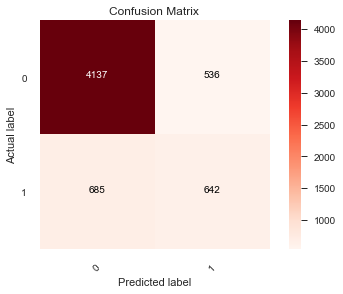

In [246]:
# Plot confusion matrix for that prediction

cm=confusion_matrix(y_test, y_hat_03)
print(cm)
plot_confusion_matrix(cm)
#

**PROBLEM**: How many errors did the OLS make?

In [247]:
# How many errors did the dumb model make?


536+685

1221

In [257]:
(abs(y_test-y_hat_03)).sum()

1221

**PROBLEM**: Calculate the accuracy. Is this model significantly more accurate than the baseline model? Comment on the importance of this difference.

In [186]:
# Calculate accuracy


accuracy_score(y_test, y_hat_03)

0.7965

ANSWER:  Baseline accuracy = 0.77883, linear regrssion is not significantly accurate in comparison with the baseline, but we have improved our model even though slightly

**PROBLEM**: Use the `roc_auc_score()` function from sklearn to calculate the AUC score. What does this number tell you?

In [201]:
# Calculate AUC

#for y_score - In the binary and multilabel cases, these can be either
#probability estimates or non-thresholded decision values
roc_auc_score(y_test, y_hat_lr) 

0.7162711086520376

ANSWER:  More than random guess, but far from ideal (1)

# PART 5: LINEAR PROBABILITY MODEL #2

Repeat the prediction with the SAME linear (OLS) probability model estimated above -- but now change to a probability threshold of 0.60 (i.e. predict Positive Case when prob >= 0.60). 

**PROBLEM**: Manually calculate how many errors this linear probability model with a threshold of 0.60 makes. (i.e., do the calculation in poure python - do NOT use sklearn).

In [188]:
# Using the SAME linear probability model that we fit earlier
# Make a prediction of positive cases at 0.60 probability threshold

y_hat_06 = np.where(y_hat_lr>=0.6, 1, 0)



**PROBLEM**: Manually calculate how many errors this model makes. (i.e., do the calculation in pure python - do NOT use sklearn).

In [258]:
# Without using sklearn, calculate how many errors this model makes

(abs(y_hat_06-y_test)).sum()


1289

**PROBLEM**: Calculate how many errors this model makes, but now extract the errors from values returned by the sklearn confusion matrix function.

In [164]:
# Now USE the sklearn confusion matrix function to calculate how many errors this model makes

confusion_matrix(y_test,y_hat_06)


array([[4653,   20],
       [1269,   58]])

In [159]:
confusion_matrix(y_test,y_hat_06)[0,1]+confusion_matrix(y_test,y_hat_06)[1,0]


1289

**PROBLEM**: Calculate accuracy. Does it make sense? Why or why not? Is this a good measure? why or why not?

In [160]:
# Calculate accuracy

accuracy_score(y_test, y_hat_06)


0.7851666666666667

**PROBLEM**: Did the accuracy go up or down by raising the probability threshold? Would that always happen when moving from a probability threshold of 0.3 to 0.6 (yes/no)? Why?

ANSWER:  for treshold 0.3 acc=0.7965, for 0.6 acc =0.785
The accuracy goes down. No, it depends on the balance of zeros and 1s in our data

**PROBLEM**: Finally, plot the ROC curve for the linear probability model. HINT: use the `plot_roc()` custom function defined at the start of the notebook.

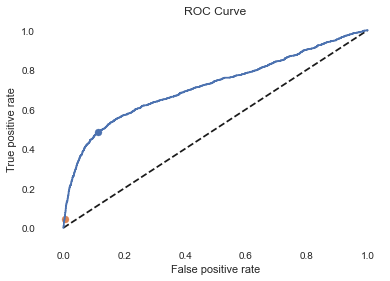

'array([[4653,   20],\n       [1269,   58]])'

In [235]:
fpr, tpr, thresholds = roc_curve(y_test, y_hat_lr)
#for threshold=0,03:
plt.scatter(536/(4137+536),642/(685+642))
#for threshold=0,06:
plt.scatter(20/(4653+20),58/(1269+58))
plot_roc(fpr,tpr)

plt.show()

#for threshold=0,03:
"""[[4137  536]
 [ 685  642]]"""
#for threshold=0,06:
"""array([[4653,   20],
       [1269,   58]])"""

**PROBLEM**: What is the AUC for this model?

In [195]:
roc_auc_score(y_test, y_hat_lr) 



0.7162711086520376

**PROBLEM**: Does the linear probabily model outperform the baseline?

ANSWER:   Baseline accuracy = 0.77883, For threshold 0,3 accuracy =0.7965
For threshold 0,6 accuracy =0.785.
The linear probabily model outperform the baseline

# **PART 6**: OPTIMIZE THE LINEAR PROBABILITY MODEL

**PROBLEM**: Find and report the optimal probability threshold for the linear probability model, when maximizing for accuracy.

In [206]:

acc_all_thresholds=[accuracy_score(y_test,np.where(y_hat_lr>=threshold, 1, 0)) for threshold in thresholds]

In [210]:
print('Best Threshold=%f, Accuracy=%.3f' % (thresholds[np.argmax(acc_all_thresholds)],
                                            acc_all_thresholds[np.argmax(acc_all_thresholds)]))

Best Threshold=0.400541, Accuracy=0.816


**PROBLEM**: Plot the accuracy across probability thresholds; plot a vertical line for your optimal threshold.

In [304]:
SLEEP      = 0.75  # sleep time in seconds
FONTSIZE   = 20
FIGSIZE    = (8, 8)
OFFSET     = 0.05  # plot offset on x and y axes
font = {'size'   : FONTSIZE}
matplotlib.rc('font', **font)


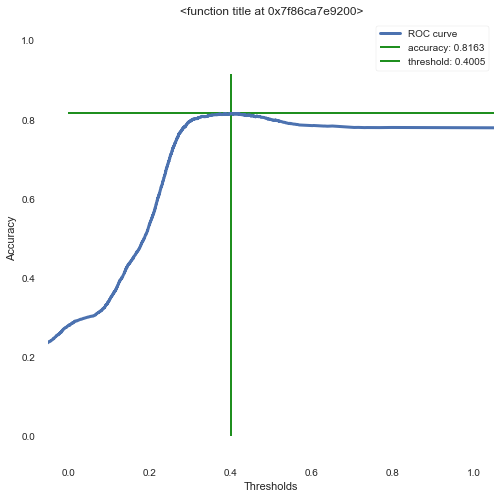

In [317]:
plt.figure(figsize=FIGSIZE)
plt.ylim(0 - OFFSET, 1 + OFFSET)
plt.xlim(0 - OFFSET, 1 + OFFSET)

plt.plot(thresholds,acc_all_thresholds, linestyle = '-', marker = 'o', markersize=1, linewidth=3, label='ROC curve')
plt.hlines(acc_all_thresholds[np.argmax(acc_all_thresholds)],
    xmin = 0, xmax = 1.2, 
    color = 'green', label='accuracy: {}'.format(round(acc_all_thresholds[np.argmax(acc_all_thresholds)], 4)))
plt.vlines(thresholds[np.argmax(acc_all_thresholds)] , ymin = 0, ymax = max(acc_all_thresholds)+0.1, color = 'green', label='threshold: {}'.format(round(thresholds[np.argmax(acc_all_thresholds)], 4)))
plt.xlabel('Thresholds')
plt.ylabel('Accuracy')
plt.title(str(title))
plt.legend()
plt.show()
    


**PROBLEM**: Now cosider a case where all errors are not valued equally; instead, a false negative is four times as costly as a false positive. Find and report the optimal probability threshold for the linear probability model given these weights.

In [344]:
#*min fp+fn  given 4*fn+fp-> max
expected_costs = []


fpr, tpr, thresholds = roc_curve(y_test, y_hat_lr)
for i, threshold in enumerate(thresholds):
    cm = confusion_matrix(y_test, np.where(y_hat_lr>=threshold, 1, 0))
    tn, fp, fn, tp = cm.ravel()
    
    # compute expected costs
    expected_cost = - (fp + 4*fn)
    expected_costs.append(expected_cost)
    

In [345]:
pd.Series(expected_costs)[pd.Series(expected_costs)==max(expected_costs)]

640   -3191
646   -3191
652   -3191
dtype: int64

In [356]:
#*min fp+fn  given 4*fn+fp-> max
optimal_threshold = -1
optimal_threshold_list=[]
optimal_accuracy_list=[]
fpr, tpr, thresholds = roc_curve(y_test, y_hat_lr)
for i, threshold in enumerate(thresholds):
    cm = confusion_matrix(y_test, np.where(y_hat_lr>=threshold, 1, 0))
    tn, fp, fn, tp = cm.ravel()
    
    expected_cost = - (fp + 4*fn)
    if expected_cost==max(expected_costs):
        optimal_threshold_list.append(threshold)
        optimal_accuracy_list
        optimal_accuracy_list.append(accuracy_score(y_test,np.where(y_hat_lr>=threshold, 1, 0)))
optimal_threshold=optimal_threshold_list[np.argmax(optimal_accuracy_list)]
print(optimal_threshold_list)
print(optimal_accuracy_list)
print(optimal_threshold)

[0.27393776271492243, 0.2723994832485914, 0.271647616289556]
[0.7666666666666667, 0.7641666666666667, 0.7626666666666667]
0.27393776271492243


In [357]:
# our threshold is lower than 0,4 as should be

**PROBLEM**: Plot a score for weighted errors across probability thresholds; plot a vertical line for your optimal threshold.

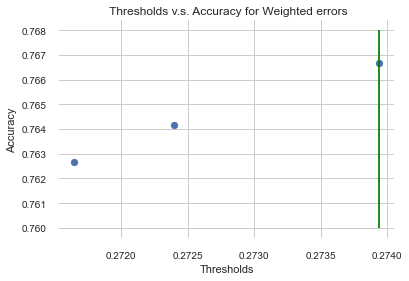

In [364]:
plt.grid()
plt.scatter(optimal_threshold_list,optimal_accuracy_list)
plt.xlabel('Thresholds')
plt.ylabel('Accuracy')
plt.title(str(title))
plt.title(' Thresholds v.s. Accuracy for Weighted errors')
plt.vlines(optimal_threshold,
    ymin = 0.76, ymax = 0.768, 
    color = 'green', label='accuracy: {}'.format(round(acc_all_thresholds[np.argmax(acc_all_thresholds)], 4)))
plt.show()
    
    



# **PART 7**: LOGIT MODEL
Repeat the analysis using a logit model. You can start with the code below, as it shows you how to setup, fit, and predict with a logit model in sklearn.

In [365]:
# Binary classification using a logit model
logit_model = LogisticRegression()
logit_model.fit(X_train, y_train)
y_hat_logit = logit_model.predict(X_test)
y_hat_logit_prob = logit_model.predict_proba(X_test)

**PROBLEM**: Calculate the accuracy of the model.

In [367]:
# What is the accuracy of the logit model?
accuracy_score(y_test,y_hat_logit)



0.7783333333333333

**PROBLEM**: Plot a confusion matrix.

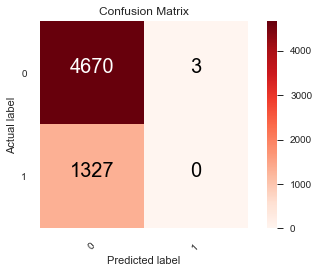

In [368]:
# Plot confusion matrix
plot_confusion_matrix(confusion_matrix(y_test,y_hat_logit))



**PROBLEM**: How many errors did the model make?

In [369]:
# How many total errors did it make?


3+1327

1330

In [370]:
abs(y_test-y_hat_logit).sum()

1330

**PROBLEM**: Calculate the accuracy.

In [371]:
# Calculate accuracy

#baseline accuracy = 0.7788
accuracy_score(y_test,y_hat_logit)

0.7783333333333333

**PROBLEM**: Note that the logit did WORSE than the baseline model in the results above (at least when predicting class labels with a default probability threshold and when evaluated by the total number of errors made by the model). Using accuracy to compare models, however, as two drawbacks for the credit default problem. Describe those problems and potential solutions.

ANSWER:  
The first problem is relared to the imbalanced sample.
If there is 95 objects that have target 1, 5 that have target 0 and we use useless algorithm that assigns for all objects 1, we get accuracy 95%. The acc is good but the alg doesn't make sense.


The second problem is that the accuracy doesn't consider the cost of differenr errors, it assigns equal cost to false positives and false negatives. 
For example, we have model 1: 80 cases do not default, 20 cases default 
and 
model2: 49 cases do not default, 2 cases default. 
By accuracy we do not understand which model is better. The 2nd model is more conservative, if use it to decide to whom we will give a credit, almost all the clients will returm but we will do not get money from potential clients that we did not give a creditt but they would return money. The 1st model is more risky. We will earn more because we will give more credits but there will be losses related to clients that will not return credit. So depending on these losses we will choose the right model


**PROBLEM**: Now describe potential solutions to the problems you identified immeidately above.

ANSWER: *The Solution to solve the 1st problem: measure ratio of the most frequent class and the acc of alg should be more than this ration
In our example alg has to have acc more than 0,778
*Another solution is to use a combination precision and recall metrics, analyse confusion matrix, use f-metric

**PROBLEM**: Compare the accuracies between the linear probability model with a threshold at 0.6 and the default logit model? Do the results make sense? Why or why not?

ANSWER:  the acc of the linear probability model with a threshold at 0.6 = 0.7851666666666667 and of the logit = 0.778333333 
The ratio of the most frequent class is 0.7788 so the result of the logit model doesn't make sense


In [372]:
#remember ration
(len(y_train)-y_train.sum())/len(y_train)

0.7787916666666667

**PROBLEM**: Calculate the AUC score. Does it make sense? Why or why not?

In [379]:
# Calculate AUC

roc_auc_score(y_test,y_hat_logit_prob[:,1])

0.6432077620140133

In [ ]:
#Less than in linear regression model which shows that our logistic regression is not good model

**PROBLEM**: Finally, plot the ROC curves for BOTH the linear probability model and the logit model in one graph. HINT: Now you cannot use the `plot_roc()` custom function defined above - but you may want to look at it for ideas about what to do.

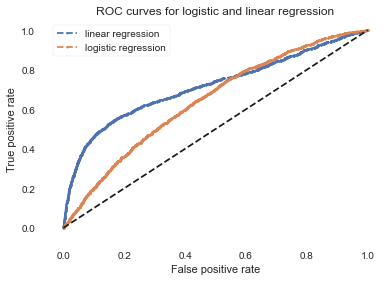

In [393]:
fpr_lr, tpr_lr, _ = roc_curve(y_test, y_hat_lr)
fpr_logit,tpr_logit,_=roc_curve(y_test, y_hat_logit_prob[:,1])
plt.plot(fpr_lr, tpr_lr,marker='o',linestyle = '--',markersize=2,label='linear regression')
plt.plot(fpr_logit,tpr_logit,linestyle = '--',marker='o',markersize=2,label='logistic regression')
plt.plot([0, 1], [0, 1], 'k--')

plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curves for logistic and linear regression')
plt.legend()
plt.show()

**PROBLEM**: Under what conditions might you want to use a logit model, even though you got the AUC results that you did?

ANSWER: if we need a high sensitivity - false negative has high cost  

# **PART 8**: MANUAL REPLICATION 

Next you will manually replicate aspects of the results above to show that you understand how each of these models or plots works. You have learned the general concepts for these in class, but you may now need to search online to learn more -- especially with respect to how to code each problem. Self-dorected learning online is an objective of the assignment. 

**PROBLEM**: Print out the coefficients for the Linear OLS Model, and the Linearized Logit Model, that you fit above, out to 6 decimal points. 

In [485]:
# Code to answer Problem
np.set_printoptions(suppress=True,
   formatter={'float_kind':'{:f}'.format})
np.round(lr.coef_,6),lr.intercept_,np.around(logit_model.coef_,6),logit_model.intercept_


(array([0.004360, -0.000001, 0.000000, 0.019656, 0.001176, -4414460.306799,
        -0.000000, -0.000000, 0.000000, -0.000000, 0.000000,
        -4414460.314034, 0.000000, -306945.397034, 0.096519, 0.005105,
        0.010923, -306945.413103, -0.001029, -4414460.336559, -0.000000,
        0.000000, -0.000000, -0.000001, -4414460.436941, -0.000000,
        -0.014993, -0.000000]),
 4721405.989992659,
 array([[0.000000, -0.000031, -0.000007, 0.000000, -0.000002, 0.000000,
         0.000001, -0.000004, 0.000006, 0.000003, 0.000002, -0.000000,
         0.000002, -0.000000, 0.000000, 0.000000, 0.000000, -0.000000,
         0.000000, -0.000000, -0.000006, -0.000026, -0.000022, -0.000010,
         -0.000000, -0.000002, -0.000000, -0.000006]]),
 array([-0.000000]))

In [405]:
X.columns

Index(['PAY_4', 'PAY_AMT1', 'PAY_AMT3', 'PAY_2', 'AGE', 'MARRIAGE_1',
       'BILL_AMT5', 'LIMIT_BAL', 'BILL_AMT2', 'BILL_AMT4', 'BILL_AMT6',
       'MARRIAGE_3', 'BILL_AMT3', 'SEX_1', 'PAY_1', 'PAY_5', 'PAY_3', 'SEX_2',
       'PAY_6', 'MARRIAGE_2', 'PAY_AMT5', 'ID', 'PAY_AMT2', 'BILL_AMT1',
       'MARRIAGE_0', 'PAY_AMT6', 'EDUCATION', 'PAY_AMT4'],
      dtype='object')

**PROBLEM**: Do all of the coefficients have the same sign between the OLS and Logit models? Explain why or why not.

ANSWER:  no, because according to metrics accuracy and auc_roc our logit is bed model

**PROBLEM**: Manually calculate (i.e., without the help of the sklearn package) the base rate for the outcome variable `customer_default`.

In [479]:
# Code to answer Problem

y_train.sum()/len(y_train)
#(len(y_train)-y_train.sum())/len(y_train)

0.22120833333333334

**PROBLEM**: Use the OLS Model to calculate the probability of customer default _on average_ (_Hint:_ use the average level of all predictor variables and the fitted coefficients from the OLS model to make this calculation).

In [437]:
lr.coef_.shape,X.shape

((28,), (30000, 28))

In [481]:
# Code to answer Problem
#sklearn
print(lr.predict(X).mean())
X.mean(axis=0).dot(lr.coef_)+lr.intercept_

0.22127737186665958


0.22127737198024988

**PROBLEM**: How does the average base rate compare to the average predicted probability from the OLS model. Explain your finding.

ANSWER: Almost the same as should be due to the alg

**PROBLEM**: Use the Logit Model to calculate the probability of customer default _on average_ (_Hint:_ use the average level of all predictor variables and the fitted coefficients from the Logit Model to make this calculation).

In [483]:
# Code to answer Problem
print(1/(1+np.exp(-(X.mean(axis=0).dot(logit_model.coef_.reshape(28,)+logit_model.intercept_)))))
#print(1/(1+np.exp(-np.dot(X_test,logit_model.coef_.reshape(28,)).mean())))


0.20138129719095885


**PROBLEM**: Use the `.predict_proba()` method of the fitted Logit Model to calculate the probability of customer default _on average_.

In [482]:
# Code to answer Problem

print(logit_model.predict_proba(X)[:,1].mean())


0.24265214628071485


**PROBLEM, PROBLEM, PROBLEM**: Calculate and plot an ROC curve for the Logit Model using only "pure Python" to demonstrate you understand how the ROC curve works. You must __manually__ replicate the ROC curve for the Logit Model that you calculated above. You may __fit__ the logit model with `sklearn`, but you may __not__ use `sklearn` to calculate anything for the ROC curve itself. HINTS: You may __not__ use the `roc_curve()` function from `sklearn`, but instead you must calculate whatever you need to plot an ROC curve only with "pure Python". You also can __not__ use the `plot_roc()` custom function defined above - replicate it again below.

_NOTE: This problem is long and involved, so it is worth the relative points of **THREE SEPARATE "PROBLEMS."**_

In [509]:
# Code to answer Problem



#logit_model.predict_proba(X)[:,1]
#the probability to be the 1st
y_hat_man=1/(1+np.exp(-(X_test.dot(logit_model.coef_.reshape(28,)+logit_model.intercept_))))

df=pd.DataFrame()
df['Actual label']=y_test
df['Predicted Probability']=y_hat_man.values
df=df.sort_values(by='Predicted Probability',ascending=False)

In [510]:
df

,Actual label,Predicted Probability
1853,0,0.589358
2047,0,0.492844
1062,0,0.488359
83,0,0.481667
3135,0,0.479434
...,...,...
2395,0,0.000070
3095,0,0.000037
2272,0,0.000023
1995,0,0.000014


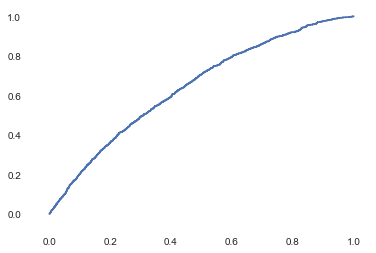

In [527]:

pos = 0
neg = 0

positives = []
negatives = []

observations = df.shape[0]

for i, row in df.iterrows():
    
    label = row['Actual label']
    prob  = row['Predicted Probability']
    
    if label == 1:
        pos += 1
        
    else:
        neg += 1
    
    positives.append(pos / df[df['Actual label']==1].shape[0])
    negatives.append(neg / df[df['Actual label']==0].shape[0])
    
    # plot draw 
plt.plot(negatives, positives)
# check
#plt.plot(fpr_logit,tpr_logit,linestyle = '--',marker='o',markersize=2,label='logistic regression')


# **PART 9**: Regularization

We will now repeat the analyses above using regularization. TIP: The process to setup, fit, and predict a  model is fairly standard in sklearn, so look over your code above and reuse portions of it whenever you can (you will save time if you don't recode everything from scratch). 



**PROBLEM**: When do we need to standardize data?

ANSWER:  When our data has varying scales and the algorithm we are using does make assumptions about our data having a Gaussian distribution, such as linear regression, logistic regression.
Also if we  care about comparing coefficient magnitudes.




**PROBLEM**: When do we need to use a _Pipeline_? (And what is a "Pipeline" in `sklearn`, anyway?) TIP: You will need to do some self-directed learning about pipelines in `sklearn` to be able to answer this question...

ANSWER:  When we want to automate machine learning workflows. Pipelines operate by enabling a sequence of data to be transformed and correlated together in a model that can be tested and evaluated to achieve an outcome, whether positive or negative.

**PROBLEM**: Was our training/testing method above robust? What would make it more robust?

ANSWER: Not robust, it is better to use stratified test train split sklearn/ cross validation




**PROBLEM**: For all of the problems that follow, divide the data into three parts:  **training** (60%), **validation** (20%) and **test** (20%). In the python code, refer to those subsets as: 

| Subset      |  Pct.  |  X code var     | Target code var |
|-------------|--------|-----------------|-----------------|
| training    |  60%   |  X_train_train  | y_train_train
| validation  |  20%   | X_train_val     | y_train_val
| testing     |  20%   | X_test          | y_test


In [529]:
# Use the sklearn train_test_split() function to split data into "train", "validation", and "test" 
# Make sure you get the split proportions we ask for above



X_train_train,  X_test, y_train_train, y_test = train_test_split(X, y, 
                                                    train_size=0.6, 
                                                    random_state=42)
X_test, X_train_val, y_test,  y_train_val=train_test_split(X_test, y_test, 
                                                    train_size=0.5, 
                                                    random_state=42)



In [532]:
X_train_train.shape[0]/X.shape[0],X_test.shape[0]/X.shape[0],X_train_val.shape[0]/X.shape[0]

(0.6, 0.2, 0.2)

# **PART 5**: Logit Model with L1 Regularization ("Lasso")
Predict credit default using a logit model. We give you a start with the code below, as __it shows you how to setup, fit, and predict with a pipeline in sklearn.__ You are welcome!

In [539]:
# Build pipeline   
from sklearn.pipeline import Pipeline
estimators = []
estimators.append(('standardize', StandardScaler()))         # tell it to standardize features
estimators.append(('logit_model_l1', LogisticRegression(solver='liblinear')))  # tell it to use a logit model
pipeline = Pipeline(estimators) 
pipeline.set_params(logit_model_l1__penalty='l1')            # tell it to regularize with L1 norm

Pipeline(memory=None,
         steps=[('standardize',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('logit_model_l1',
                 LogisticRegression(C=1.0, class_weight=None, dual=False,
                                    fit_intercept=True, intercept_scaling=1,
                                    l1_ratio=None, max_iter=100,
                                    multi_class='auto', n_jobs=None,
                                    penalty='l1', random_state=None,
                                    solver='liblinear', tol=0.0001, verbose=0,
                                    warm_start=False))],
         verbose=False)

Tune for the optimal amount of regularization (the tuning parameter `c` in sklearn). We will again give you this code to show you the general pattern for how to setup hyper-parameter tuning in sklearn.

In [540]:
# Tune C  
results = []
for c in np.logspace(-4, 5, 10):
    pipeline.set_params(logit_model_l1__C=c) 
    pipeline.fit(X_train_train,y_train_train)
    y_train_pred = pipeline.predict_proba(X_train_val)       # use validation set during hyper-parameter tuning
    auc_lml1 = roc_auc_score(y_train_val, y_train_pred[:,1])   
    results.append( (auc_lml1, c)  )
logit_model_l1 = pipeline.named_steps['logit_model_l1']      # capture model so we can use it later

**PROBLEM**: Make a table of the results from hyper-parameter tuning so you can inspect them. 

In [541]:
# View results 
results


[(0.5, 0.0001),
 (0.7052531188945905, 0.001),
 (0.7311046797537246, 0.01),
 (0.7330293808404914, 0.1),
 (0.73410158513007, 1.0),
 (0.7342167531008104, 10.0),
 (0.734224367512099, 100.0),
 (0.7342273815499007, 1000.0),
 (0.734224367512099, 10000.0),
 (0.734224367512099, 100000.0)]

**PROBLEM**: Pick what you believe to be the "best" value for c. Justify your selection. 

In [551]:
# Select best C  

pd.DataFrame(results,columns=['roc_auc','c'])[pd.DataFrame(results,columns=['roc_auc','c']).roc_auc==pd.DataFrame(results,columns=['roc_auc','c']).roc_auc.max()]


,roc_auc,c
7,0.734227,1000.0


ANSWER: Choose c where roc_auc is maximum


**PROBLEM**: Test the final model, using the selected best value for C. Report the final testing score and plot the ROC.

ROC_auc = 0.7221973088619399


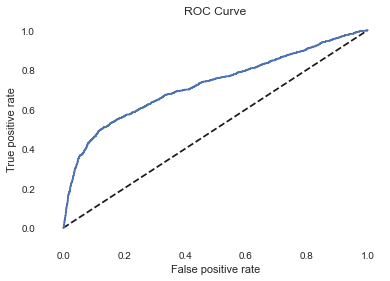

In [574]:
# Test final model 
pipeline.set_params(logit_model_l1__C=1000.0) 
best_estimator=pipeline.fit(X_train_train,y_train_train)
y_test_pred = best_estimator.predict_proba(X_test)       # use validation set during hyper-parameter tuning
print('ROC_auc =',roc_auc_score(y_test, y_test_pred[:,1]))
fpr_logit2,tpr_logit2,_=roc_curve(y_test, y_test_pred[:,1])
plot_roc(fpr_logit2,tpr_logit2)
#this model is better than lr

**PROBLEM**: Compare coefficients between a standard logit model and a regularized logit model, to see how Lasso drops predictors.

In [584]:
# Compare coefficients between a standard logit model and a regularized logit model, to see how Lasso drops predictors
print(np.around(logit_model.coef_,6),logit_model.intercept_)
print(best_estimator['logit_model_l1'].coef_,best_estimator['logit_model_l1'].intercept_)


[[0.000000 -0.000031 -0.000007 0.000000 -0.000002 0.000000 0.000001
  -0.000004 0.000006 0.000003 0.000002 -0.000000 0.000002 -0.000000
  0.000000 0.000000 0.000000 -0.000000 0.000000 -0.000000 -0.000006
  -0.000026 -0.000022 -0.000010 -0.000000 -0.000002 -0.000000 -0.000006]] [-0.000000]
[[0.056521 -0.168307 -0.094970 0.111984 0.059735 0.036875 -0.081357
  -0.098441 0.149489 0.000912 0.039744 -0.009344 0.155306 -0.020231
  0.634880 0.000244 0.086726 -0.065338 0.029479 -0.048970 -0.039919
  -0.006762 -0.284518 -0.388319 -0.048406 -0.058003 -0.090967 -0.032410]] [-1.461966]


In [599]:
df_weights=pd.DataFrame()
df_weights['columns']=list(X.columns)
df_weights['simple_logit']=list(np.around(logit_model.coef_,6)[0])
df_weights['lasso_logit']=best_estimator['logit_model_l1'].coef_[0]



In [601]:
df_weights[df_weights.simple_logit>df_weights.lasso_logit]

,columns,simple_logit,lasso_logit
1,PAY_AMT1,-0.000031,-0.168307
2,PAY_AMT3,-0.000007,-0.094970
6,BILL_AMT5,0.000001,-0.081357
7,LIMIT_BAL,-0.000004,-0.098441
11,MARRIAGE_3,-0.000000,-0.009344
13,SEX_1,-0.000000,-0.020231
17,SEX_2,-0.000000,-0.065338
19,MARRIAGE_2,-0.000000,-0.048970
20,PAY_AMT5,-0.000006,-0.039919
21,ID,-0.000026,-0.006762


**PROBLEM**: Comment on which predictors dropped, and why. HINT: Maybe plot a fast-and-rough correlation matrix to test a hunch if you have a hunch.

<AxesSubplot:>

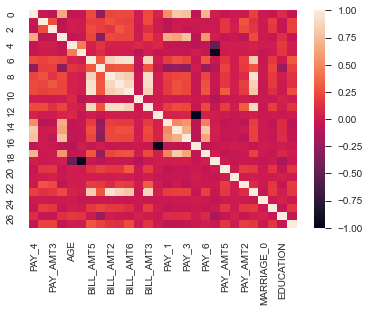

In [606]:
# Code to answer Problem
corr_matric=pd.DataFrame(np.corrcoef(X.values, rowvar=False), columns=X.columns)
sns.heatmap(corr_matric)

<AxesSubplot:>

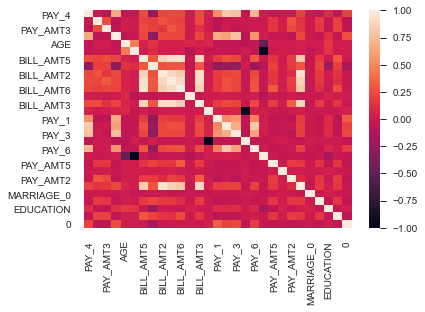

In [627]:
sns.heatmap(pd.concat([X,pd.Series(y)],axis=1).corr())

In [652]:
cor_m=pd.concat([X,pd.Series(y)],axis=1).corr()

In [668]:
pd.concat([X[list(df_weights[df_weights.simple_logit>df_weights.lasso_logit]['columns'])],pd.Series(y)],axis=1).corr().iloc[:,-1].sort_values()

LIMIT_BAL    -0.153520
PAY_AMT1     -0.072929
PAY_AMT2     -0.058579
PAY_AMT4     -0.056827
PAY_AMT3     -0.056250
PAY_AMT5     -0.055124
PAY_AMT6     -0.053183
SEX_2        -0.039961
MARRIAGE_2   -0.030619
BILL_AMT1    -0.019644
ID           -0.013952
MARRIAGE_0   -0.013158
BILL_AMT5    -0.006760
MARRIAGE_3    0.009768
EDUCATION     0.028006
SEX_1         0.039961
0             1.000000
Name: 0, dtype: float64

In [662]:
cor_m.iloc[:,-1].sort_values()

LIMIT_BAL    -0.153520
PAY_AMT1     -0.072929
PAY_AMT2     -0.058579
PAY_AMT4     -0.056827
PAY_AMT3     -0.056250
PAY_AMT5     -0.055124
PAY_AMT6     -0.053183
SEX_2        -0.039961
MARRIAGE_2   -0.030619
BILL_AMT1    -0.019644
BILL_AMT2    -0.014193
BILL_AMT3    -0.014076
ID           -0.013952
MARRIAGE_0   -0.013158
BILL_AMT4    -0.010156
BILL_AMT5    -0.006760
BILL_AMT6    -0.005372
MARRIAGE_3    0.009768
AGE           0.013890
EDUCATION     0.028006
MARRIAGE_1    0.029775
SEX_1         0.039961
PAY_6         0.186866
PAY_5         0.204149
PAY_4         0.216614
PAY_3         0.235253
PAY_2         0.263551
PAY_1         0.324794
0             1.000000
Name: 0, dtype: float64

<AxesSubplot:>

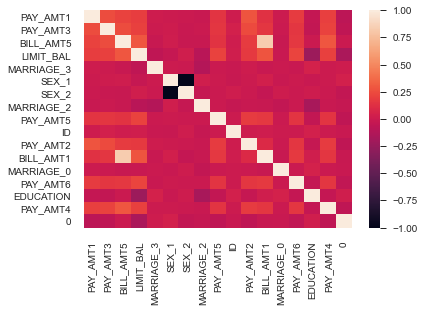

In [648]:
sns.heatmap(pd.concat([X[list(df_weights[df_weights.simple_logit>df_weights.lasso_logit]['columns'])],pd.Series(y)],axis=1).corr())

ANSWER: 
These features have the least correlation with a target


